In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from skill_acq_mdp import skill_acq_mdp_new
import random

In [2]:
Environment = skill_acq_mdp_new.Environment
# policy_iteration = skill_acq_mdp_new.policy_iteration
value_iteration = skill_acq_mdp_new.value_iteration
policy_evaluation = skill_acq_mdp_new.policy_evaluation
one_step_lookahead = skill_acq_mdp_new.one_step_lookahead
roll_out = skill_acq_mdp_new.roll_out
simulation = skill_acq_mdp_new.simulation
my_formular_vop = skill_acq_mdp_new.my_formular_vop

In [3]:
gamma = 0.94
env = Environment(0.94)
actions = env.actions
nA = env.nA

In [4]:
optimal_policy, optimal_V = value_iteration(env, gamma)

In [5]:
optimal_policy

{(1, 1, 1): array([1., 0.]),
 (1, 1, 2): array([1., 0.]),
 (1, 1, 3): array([1., 0.]),
 (1, 1, 4): array([1., 0.]),
 (1, 1, 5): array([1., 0.]),
 (1, 1, 6): array([1., 0.]),
 (1, 1, 7): array([1., 0.]),
 (1, 1, 8): array([1., 0.]),
 (1, 1, 9): array([1., 0.]),
 (1, 1, 10): array([1., 0.]),
 (1, 1, 11): array([1., 0.]),
 (1, 1, 12): array([1., 0.]),
 (1, 1, 13): array([1., 0.]),
 (1, 1, 14): array([1., 0.]),
 (1, 1, 15): array([1., 0.]),
 (1, 1, 16): array([1., 0.]),
 (1, 1, 17): array([1., 0.]),
 (1, 1, 18): array([1., 0.]),
 (1, 1, 19): array([1., 0.]),
 (1, 1, 20): array([1., 0.]),
 (1, 1, 21): array([1., 0.]),
 (1, 1, 22): array([1., 0.]),
 (1, 1, 23): array([1., 0.]),
 (1, 1, 24): array([1., 0.]),
 (1, 1, 25): array([1., 0.]),
 (1, 1, 26): array([1., 0.]),
 (1, 2, 1): array([0., 1.]),
 (1, 2, 2): array([0., 1.]),
 (1, 2, 3): array([0., 1.]),
 (1, 2, 4): array([0., 1.]),
 (1, 2, 5): array([0., 1.]),
 (1, 2, 6): array([0., 1.]),
 (1, 2, 7): array([0., 1.]),
 (1, 2, 8): array([0., 1.]

In [6]:
optimal_V

{(1, 1, 1): 316.665153393388,
 (1, 1, 2): 307.2652441897847,
 (1, 1, 3): 298.24130108886,
 (1, 1, 4): 289.57642831509247,
 (1, 1, 5): 281.25452293090643,
 (1, 1, 6): 273.2602503275075,
 (1, 1, 7): 265.5790080052753,
 (1, 1, 8): 258.196889608062,
 (1, 1, 9): 251.10065044915677,
 (1, 1, 10): 244.27767469896511,
 (1, 1, 11): 237.7159442145506,
 (1, 1, 12): 231.40400894735313,
 (1, 1, 13): 225.3309588550714,
 (1, 1, 14): 219.48639724276836,
 (1, 1, 15): 213.86041546030773,
 (1, 1, 16): 208.44356888625774,
 (1, 1, 17): 203.2268541317118,
 (1, 1, 18): 198.20168740080774,
 (1, 1, 19): 193.35988394797116,
 (1, 1, 20): 188.69363857502745,
 (1, 1, 21): 184.19550711430003,
 (1, 1, 22): 179.85838884663943,
 (1, 1, 23): 175.6755098060125,
 (1, 1, 24): 171.64040692482396,
 (1, 1, 25): 167.74691297655252,
 (1, 1, 26): 163.98914227456802,
 (1, 2, 1): 316.665153393388,
 (1, 2, 2): 306.66519879158636,
 (1, 2, 3): 297.0652423738568,
 (1, 2, 4): 287.847284221916,
 (1, 2, 5): 278.9941884135585,
 (1, 2, 6):

In [5]:
V_eval = policy_evaluation(optimal_policy, env)

In [6]:
policy_only_skill1 = {state: np.array([1, 0]) for state in env.states}
policy_only_skill2 = {state: np.array([0, 1]) for state in env.states}

### skill values for $\gamma = [0.80...0.99]$, when d = total_distance, k1 =nS1, k2=nS2

[-1.111111103711111, -1.2328742134260753, -1.3845264426070072, -1.5777484668441684, -1.8273620330546463, -2.1434199188899554, -2.5025854138074166, -2.7681661340663726, -2.441248753789362, 0.7464375997199656] [-0.16144350379867034, -0.06365755516413696, 0.09012259918574084, 0.33880194137761777, 0.7583361081788064, 1.5114569853965747, 2.994229035568822, 6.3671005930322995, 16.17231140906296, 61.952741185043074]


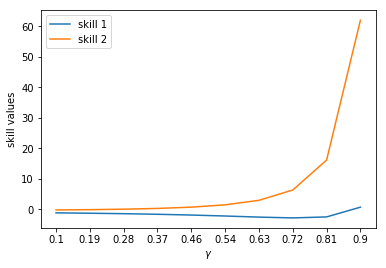

In [7]:
policy_only_skill1 = {state: np.array([1, 0]) for state in env.states}
policy_only_skill2 = {state: np.array([0, 1]) for state in env.states}
V1_init_d = []
V2_init_d = []
gamma_list = []
for gamma in np.linspace(0.1, 0.9, 10):
    gamma_list.append(gamma)
    env = Environment(gamma)
    V1 = policy_evaluation(policy_only_skill1, env)
    V2 = policy_evaluation(policy_only_skill2, env)
    V1_init_d.append(V1[(env.total_distance, env.nS1, env.nS2)])
    V2_init_d.append(V2[(env.total_distance, env.nS1, env.nS2)])
print(V1_init_d, V2_init_d)

fig, ax = plt.subplots()
ax.plot(V1_init_d, label="skill 1")
ax.set_xticks(np.arange(len(gamma_list)))
ax.set_xticklabels(round(gamma, 2) for gamma in gamma_list)
ax.set_xlabel("$\gamma$")
ax.set_ylabel("skill values")
ax.plot(V2_init_d, label="skill 2")
plt.legend()
plt.show()

### preference of learning skill 1 over skill 2 for $\gamma = [0.1, ..., 0.9]$ and for $d = [1, ..., 10]$

In [8]:
my_vop = my_formular_vop(env)

In [9]:
Z = np.zeros((10, 10))
gamma_list = []
for i, gamma in enumerate(np.linspace(0.1, 0.9, 10)):
    gamma_list.append(gamma)
    env = Environment(gamma)
    V1 = policy_evaluation(policy_only_skill1, env)
    V2 = policy_evaluation(policy_only_skill2, env)
    
    for j, d in enumerate(range(1, 11)):
        print(f"d: {d}")
        Z[i, j] = V1[(d, env.nS1, env.nS2)] - V2[(d, env.nS1, env.nS2)]
        print(f"Z at {gamma, d}: {Z[i, j]}")

d: 1
Z at (0.1, 1): 6.45033247462414
d: 2
Z at (0.1, 2): -0.2096675260418595
d: 3
Z at (0.1, 3): -0.8756675261084593
d: 4
Z at (0.1, 4): -0.9422675261151195
d: 5
Z at (0.1, 5): -0.9489275261157856
d: 6
Z at (0.1, 6): -0.9495935261158522
d: 7
Z at (0.1, 7): -0.9496601261158587
d: 8
Z at (0.1, 8): -0.9496667861158595
d: 9
Z at (0.1, 9): -0.9496674521158596
d: 10
Z at (0.1, 10): -0.9496675999124407
d: 1
Z at (0.18888888888888888, 1): 6.994567598857501
d: 2
Z at (0.18888888888888888, 2): 0.3728296759917825
d: 3
Z at (0.18888888888888888, 3): -0.8779430427717421
d: 4
Z at (0.18888888888888888, 4): -1.114200111871519
d: 5
Z at (0.18888888888888888, 5): -1.158826447145921
d: 6
Z at (0.18888888888888888, 6): -1.1672558660310859
d: 7
Z at (0.18888888888888888, 7): -1.168848089598284
d: 8
Z at (0.18888888888888888, 8): -1.1691488429387547
d: 9
Z at (0.18888888888888888, 9): -1.1692056519030656
d: 10
Z at (0.18888888888888888, 10): -1.1692166582619383
d: 1
Z at (0.2777777777777778, 1): 7.55820930

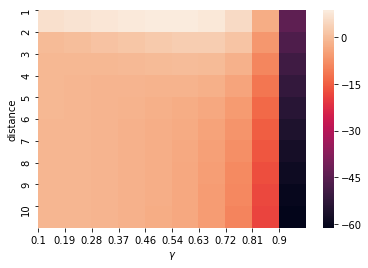

In [10]:
fig, ax = plt.subplots()

data = Z.T
# data = (data - data.min())/abs(data.max() - data.min())
ax = sns.heatmap(data)
# ax = sns.heatmap(data, vmin=0, vmax=0.0001)
ax.set_xticks(np.arange(len(gamma_list)))
ax.set_xticklabels(round(gamma, 2) for gamma in gamma_list)
ax.set_xlabel("$\gamma$")
ax.set_yticks(np.arange(env.total_distance))
ax.set_yticklabels(np.arange(1, 11))
ax.set_ylabel("distance")
# im = ax.imshow(data, interpolation='nearest')
# fig.colorbar(im)
plt.show()

### Roll out 10 steps rewards

In [61]:
participant_num = 1000

In [62]:
def delta_r_at_time_step_n(time_steps, participant_num):
    gamma_list = [] 
    delta_r_at_gamma = []
    for gamma in np.linspace(0.1, 0.9, 10):
        gamma_list.append(gamma)
        env = Environment(gamma)

        initial_state = (env.total_distance, env.nS1, env.nS2)
        current_state = initial_state

        # use only skill 1
        crash_at = []
        survival_at = []
        cumulative_return_arr_1 = np.zeros((participant_num, time_steps))
        cumulative_return_arr_2 = np.zeros((participant_num, time_steps))


        for i in range(participant_num):
            cumulative_return_list_1, _, _ = roll_out(current_state, env, 
                                                initial_state, policy_only_skill1, 
                                               time_steps, crash_at, survival_at)
            cumulative_return_list_2, _, _ = roll_out(current_state, env, 
                                                     initial_state, policy_only_skill2, 
                                                     time_steps, crash_at, survival_at)
            cumulative_return_arr_1[i, :len(cumulative_return_list_1)] = \
            cumulative_return_list_1
            cumulative_return_arr_2[i, :len(cumulative_return_list_2)] = \
            cumulative_return_list_2
            cumulative_return_arr_1[i, len(cumulative_return_list_1):] = \
            cumulative_return_list_1[-1]
            cumulative_return_arr_2[i, len(cumulative_return_list_2):] = \
            cumulative_return_list_2[-1]

        delta_r_at_gamma.append(np.mean(cumulative_return_arr_2[:, -1] - 
                                    cumulative_return_arr_1[:, -1]))
    return delta_r_at_gamma

In [63]:
delta_r_10th = delta_r_at_time_step_n(time_steps=10, 
                                      participant_num=participant_num)
delta_r_inf = delta_r_at_time_step_n(time_steps=100, 
                                    participant_num=participant_num)
delta_r_inf

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 2

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken 

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions

value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions t

next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next

reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25)

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list

value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions 

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list:

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), 

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 1

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken f

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions 

next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
stat

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.666666666

state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, 

value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_lis

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions ta

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (

next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3,

state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list

value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_lis

next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8,

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.96153846

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 2

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions 

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1),

next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
rew

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions take

next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 

value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions t

next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.03846153

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 2

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.0384615

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
nex

state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, 

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 2

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9

value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [

next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_sta

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 2

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.333333333333

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.33333

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
action

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken f

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions 

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, 

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions ta

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.96

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), 

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 2

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions

next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (

next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken f

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.

value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2,

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 2

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state 

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
va

state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_l

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_stat

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1,

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1),

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26

state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
rew

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: 

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8,

next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
va

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, 

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions 

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1,

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 2

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 1

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
n

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), 

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
nex

state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 2

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_s

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
nex

reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25):

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list

value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list

next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list:

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1)

next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state

state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_li

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
n

value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_lis

next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.04166

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions take

state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_l

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
nex

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538

actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_sta

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions 

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10,

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 2

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions 

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions take

reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25)

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464,

actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (

next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_li

actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken f

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.

value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_pro

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10,

actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), 

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_

value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.961

next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565

next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: 

actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.96

value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken fo

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: 

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
action

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
action

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1),

next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19)

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list:

value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
act

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_li

reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for 

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.66666666666

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9

next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.04347

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list

reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10

next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list

actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for

next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
st

value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)


next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state:

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-

next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.961538

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current s

actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions ta

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions t

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
nex

value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_lis

next_state: (10, 3, 19)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
va

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 2

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: 

state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list:

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_st

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
valu

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19)

state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.9

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), (

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
nex

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: 

next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.95833333333

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: 

value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_pro

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10

actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1,

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list

value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
action

next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.95833333333

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_stat

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_s

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_pro

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.04166

actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1,

state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5

next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state

actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for

next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 1

state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: 

state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.04347

actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for c

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for

next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next

next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)

value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, 

next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3,

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.04166

next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1,

state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 2

actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions take

actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list

state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((

next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 2

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2,

next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.33

next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
st

next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 

value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
acti

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_l

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.0434782608695

value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list:

value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333

next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]

value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)


next_state: (2, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8,

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1,

actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_l

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current s

value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, 

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions 

reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_

state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]


actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions

next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 2

value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
n

reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 

next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464,

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -

actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616,

state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [(

value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
ac

next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (

reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3,

next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.

state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list

actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10

next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
action

value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_lis

next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1,

reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26):

reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1,

next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_p

next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (

next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (

value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list:

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1,

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1)

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.96153846

next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.

state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list:

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10

actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]

state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
ac

value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_

next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1

actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list

next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state 

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_stat

actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions take

next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state:

state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, 

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19)

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state

next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 

reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26)

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list

state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.03846

next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next

actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.941

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1,

state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actio

actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -

actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_stat

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list

value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_

actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), 

actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for

state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list:

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list

reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 2

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.0384615

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
action

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 2

actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]

value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_

next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
nex

reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3

next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.03846153

next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10

actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19)

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -

next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_p

next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: 

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((

value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions 

next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list:

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1,

next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
val

next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state

reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]

actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list:

state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
acti

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
rewar

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_lis

actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10

state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]


state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_lis

reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions t

reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10

value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
ac

value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_

actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list

next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.95833333333

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_s

value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state

next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 2

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, 

value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_sta

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_s

actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions take

next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.95833333333

value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)


value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [

next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current s

state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_lis

actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for

actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.94

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list

value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)


next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1

next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (

value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_pr

next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10,

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-

value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 

value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list:

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for c

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken f

next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8,

next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8,

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-

value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
acti

value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions 

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions 

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0

next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions take

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))

next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
nex

next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666

value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions 

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions ta

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_s

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions 

value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5,

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_lis

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24

next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 

next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions 

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_l

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [(

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions t

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), 

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]


next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: 

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), (

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
nex

next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
nex

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list:

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664,

state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken f

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 

next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next

next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
sta

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), 

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for c

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]


reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
nex

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.961538

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions 

actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1,

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_lis

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.956

next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
va

next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list:

next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
st

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6

actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96153846

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
valu

next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.

value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538

next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for c

next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -

state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.0

actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list

value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions 

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for c

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]


next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2,

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1)

next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
sta

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10

next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2,

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((

value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list:

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(

state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 2

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: 

next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_li

next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10

next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [

state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: 

state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
rew

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 

state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken f

next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state:

state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.0

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions 

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions ta

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
rew

reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1,

reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26)

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [(

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: 

value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_pro

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions take

next_state: (10, 3, 19)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next

value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [(

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 

actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_stat

next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_p

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_lis

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1),

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
st

next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3,

next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)),

next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 1

state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.33333

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), 

reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26)

value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_pr

value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_li

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions ta

next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.

next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
nex

next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list

next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3,

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_li

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for

actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_sta

next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]

next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1,

next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26

next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 2

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.04347

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for

actions taken for current state (10, 3, 16): 1
value_list: [((0.9375, -1), (10, 3, 15)), ((0.0625, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9375, 0.0625]
next_state_list: [(10, 3, 15), (10, 3, 1)]
next_state: (10, 3, 15)
actions taken for current state (10, 3, 15): 1
value_list: [((0.9333333333333333, -1), (10, 3, 14)), ((0.06666666666666667, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9333333333333333, 0.06666666666666667]
next_state_list: [(10, 3, 14), (10, 3, 1)]
next_state: (10, 3, 14)
actions taken for current state (10, 3, 14): 1
value_list: [((0.9285714285714286, -1), (10, 3, 13)), ((0.07142857142857142, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9285714285714286, 0.07142857142857142]
next_state_list: [(10, 3, 13), (10, 3, 1)]
next_state: (10, 3, 13)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: 

next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: 

state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 

state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_l

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
stat

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions t

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1

actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1,

next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3

next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9,

next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list

state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
action

reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2,

actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for c

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_l

next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state:

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions 

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 26): 0
value_list

value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_sta

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869

state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_li

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
nex

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list:

next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04

next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
val

next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 16): 1
value_list: [((0.9375, -1), (10, 3, 15)), ((0.0625, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9375, 0.0625]
next_state_list: [(10, 3, 15), (10, 3, 1)]
next_state: (10, 3, 15)
actions taken for current state (10, 3, 15): 1
value_list: [((0.9333333333333333, -1), (10, 3, 14)), ((0.06666666666666667, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9333333333333333, 0.06666666666666667]
next_state_list: [(10, 3, 14), (10, 3, 1)]
next_state: (10, 3, 14)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list:

next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 2

state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list

state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464,

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10,

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 

value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
nex

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state

actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions ta

next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.03

state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_

actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken fo

actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_l

reward_list: [-1, 19]
state_prob_list: [0.9333333333333333, 0.06666666666666667]
next_state_list: [(10, 3, 14), (10, 3, 1)]
next_state: (10, 3, 14)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26):

reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.666

value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
a

value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions

actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26)

actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), 

next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_

next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384

next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1),

state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current s

state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 26): 0
value_list

actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_sta

actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 16): 1
value_list: [((0.9375, -1), (10, 3, 15)), ((0.0625, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9375, 0.0625]
next_state_list: [(10, 3, 15), (10, 3, 1)]
next_state: (10, 3, 15)
actions taken for current state (10, 3, 15): 1
value_list: [((0.9333333333333333, -1), (10, 3, 14)), ((0.06666666666666667, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_lis

state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actio

value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_pro

next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.66666666666

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
st

next_state: (10, 3, 16)
actions taken for current state (10, 3, 16): 1
value_list: [((0.9375, -1), (10, 3, 15)), ((0.0625, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9375, 0.0625]
next_state_list: [(10, 3, 15), (10, 3, 1)]
next_state: (10, 3, 15)
actions taken for current state (10, 3, 15): 1
value_list: [((0.9333333333333333, -1), (10, 3, 14)), ((0.06666666666666667, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9333333333333333, 0.06666666666666667]
next_state_list: [(10, 3, 14), (10, 3, 1)]
next_state: (10, 3, 14)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.

next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_

next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.0588235294117647

next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3

next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_lis

value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_li

actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions 

value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_

value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_p

actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions ta

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1,

next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state:

next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 

reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26):

actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96153846

state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: 

value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
ac

next_state_list: [(10, 3, 14), (10, 3, 1)]
next_state: (10, 3, 14)
actions taken for current state (10, 3, 14): 1
value_list: [((0.9285714285714286, -1), (10, 3, 13)), ((0.07142857142857142, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9285714285714286, 0.07142857142857142]
next_state_list: [(10, 3, 13), (10, 3, 1)]
next_state: (10, 3, 13)
actions taken for current state (10, 3, 13): 1
value_list: [((0.9230769230769231, -1), (10, 3, 12)), ((0.07692307692307693, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9230769230769231, 0.07692307692307693]
next_state_list: [(10, 3, 12), (10, 3, 1)]
next_state: (10, 3, 12)
actions taken for current state (10, 3, 12): 1
value_list: [((0.9166666666666666, -1), (10, 3, 11)), ((0.08333333333333333, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9166666666666666, 0.08333333333333333]
next_state_list: [(10, 3, 11), (10, 3, 1)]
next_state: (10, 3, 11)
actions taken for current state (10, 3, 11): 1
value_list: [((0

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1,

next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.

state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_

actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_

actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 2

state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: 

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1,

actions taken for current state (10, 3, 11): 1
value_list: [((0.9090909090909091, -1), (10, 3, 10)), ((0.09090909090909091, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9090909090909091, 0.09090909090909091]
next_state_list: [(10, 3, 10), (10, 3, 1)]
next_state: (10, 3, 10)
actions taken for current state (10, 3, 10): 1
value_list: [((0.9, -1), (10, 3, 9)), ((0.1, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9, 0.1]
next_state_list: [(10, 3, 9), (10, 3, 1)]
next_state: (10, 3, 9)
actions taken for current state (10, 3, 9): 1
value_list: [((0.8888888888888888, -1), (10, 3, 8)), ((0.1111111111111111, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.8888888888888888, 0.1111111111111111]
next_state_list: [(10, 3, 8), (10, 3, 1)]
next_state: (10, 3, 8)
actions taken for current state (10, 3, 8): 1
value_list: [((0.875, -1), (10, 3, 7)), ((0.125, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.875, 0.125]
next_state_list: [(10, 3, 7), (10,

next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_p

next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_p

next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
acti

next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
ac

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list

state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_

actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_sta

actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list

value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_lis

actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for c

actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 16): 1
value_list: [((0.9375, -1), (10, 3, 15)), ((0.0625, 19), (10, 3, 1))]
reward_list

next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_stat

next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_s

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list

next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 

state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list

state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_

actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_

next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_lis

reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list:

reward_list: [-1, 19]
state_prob_list: [0.9230769230769231, 0.07692307692307693]
next_state_list: [(10, 3, 12), (10, 3, 1)]
next_state: (10, 3, 12)
actions taken for current state (10, 3, 12): 1
value_list: [((0.9166666666666666, -1), (10, 3, 11)), ((0.08333333333333333, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9166666666666666, 0.08333333333333333]
next_state_list: [(10, 3, 11), (10, 3, 1)]
next_state: (10, 3, 11)
actions taken for current state (10, 3, 11): 1
value_list: [((0.9090909090909091, -1), (10, 3, 10)), ((0.09090909090909091, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9090909090909091, 0.09090909090909091]
next_state_list: [(10, 3, 10), (10, 3, 1)]
next_state: (10, 3, 10)
actions taken for current state (10, 3, 10): 1
value_list: [((0.9, -1), (10, 3, 9)), ((0.1, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9, 0.1]
next_state_list: [(10, 3, 9), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
v

value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_l

value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1,

actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 

actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_stat

next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_p

next_state: (10, 3, 11)
actions taken for current state (10, 3, 11): 1
value_list: [((0.9090909090909091, -1), (10, 3, 10)), ((0.09090909090909091, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9090909090909091, 0.09090909090909091]
next_state_list: [(10, 3, 10), (10, 3, 1)]
next_state: (10, 3, 10)
actions taken for current state (10, 3, 10): 1
value_list: [((0.9, -1), (10, 3, 9)), ((0.1, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9, 0.1]
next_state_list: [(10, 3, 9), (10, 3, 1)]
next_state: (10, 3, 9)
actions taken for current state (10, 3, 9): 1
value_list: [((0.8888888888888888, -1), (10, 3, 8)), ((0.1111111111111111, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.8888888888888888, 0.1111111111111111]
next_state_list: [(10, 3, 8), (10, 3, 1)]
next_state: (10, 3, 8)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_lis

state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 2

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1,

value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1

value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions

next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_lis

next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19

state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 26): 0
value_list

state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_lis

reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 16): 1
value_list: [((0.9375, -1), (10, 3, 15)), ((0.0625, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9375, 0.0625]
next_state_list: [(10, 3, 15), (10, 3, 1)]
next_state: (10, 3, 15)
actions taken for current state (10, 3, 15): 1
value_list: [((0.9333333333333333, -1), (10, 3, 14)), ((0.06666666666666667, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9333333333333333, 0.06666666666666667]
next_state_list: [(10, 3, 14), (10, 3, 1)]
next_state: (10, 3, 14)
actions taken for current stat

reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list:

value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_

value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_p

actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_

next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_

state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list

state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_state_list: [(10, 3, 21), (10, 3, 1)]
next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 2

actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_

actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state_list: [(10, 3, 16), (10, 3, 1)]
next_state: (10, 3, 16)
actions taken for current state (10, 3, 16): 1
value_list: [((0.9375, -1), (10, 3, 15)), ((0.0625, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9375, 0.0625]
next_state_list: [(10, 3, 15), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]


next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value

next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_p

actions taken for current state (10, 3, 9): 1
value_list: [((0.8888888888888888, -1), (10, 3, 8)), ((0.1111111111111111, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.8888888888888888, 0.1111111111111111]
next_state_list: [(10, 3, 8), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current

reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3,

value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [(

value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9411764705882353, 0.058823529411764705]
next_state

actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for cu

actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_sta

next_state: (10, 3, 21)
actions taken for current state (10, 3, 21): 1
value_list: [((0.9523809523809523, -1), (10, 3, 20)), ((0.047619047619047616, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19

state_prob_list: [0.9523809523809523, 0.047619047619047616]
next_state_list: [(10, 3, 20), (10, 3, 1)]
next_state: (10, 3, 20)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions ta

reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_st

reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]

value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions

value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
ac

actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0

actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for

next_state: (10, 3, 16)
actions taken for current state (10, 3, 16): 1
value_list: [((0.9375, -1), (10, 3, 15)), ((0.0625, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9375, 0.0625]
next_state_list: [(10, 3, 15), (10, 3, 1)]
next_state: (10, 3, 15)
actions taken for current state (10, 3, 15): 1
value_list: [((0.9333333333333333, -1), (10, 3, 14)), ((0.06666666666666667, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9333333333333333, 0.06666666666666667]
next_state_list: [(10, 3, 14), (10, 3, 1)]
next_state: (10, 3, 14)
actions taken for current state (10, 3, 14): 1
value_list: [((0.9285714285714286, -1), (10, 3, 13)), ((0.07142857142857142, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9285714285714286, 0.07142857142857142]
next_state_list: [(10, 3, 13), (10, 3, 1)]
next_state: (10, 3, 13)
actions taken for current state (10, 3, 13): 1
value_list: [((0.9230769230769231, -1), (10, 3, 12)), ((0.07692307692307693, 19), (10, 3, 1))]
reward_list: [

next_state: (9, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next

next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: 

next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 25)
actions taken for current state (10, 3, 25): 1
value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (

state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (10, 3, 26): 1
value_list: [((0.9615384615384616, -1), (10, 3, 25)), ((0.038461538461538464, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9615384615384616, 0.038461538461538464]
next_state_list: [(10, 3, 25), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_li

state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0

reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0

reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1,

value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26

value_list: [((0.96, -1), (10, 3, 24)), ((0.04, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 24)
actions taken for current state (10, 3, 24): 1
value_list: [((0.9583333333333334, -1), (10, 3, 23)), ((0.041666666666666664, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9583333333333334, 0.041666666666666664]
next_state_list: [(10, 3, 23), (10, 3, 1)]
next_state: (10, 3, 23)
actions taken for current state (10, 3, 23): 1
value_list: [((0.9565217391304348, -1), (10, 3, 22)), ((0.043478260869565216, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9565217391304348, 0.043478260869565216]
next_state_list: [(10, 3, 22), (10, 3, 1)]
next_state: (10, 3, 22)
actions taken for current state (10, 3, 22): 1
value_list: [((0.9545454545454546, -1), (10, 3, 21)), ((0.045454545454545456, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9545454545454546, 0.045454545454545456]
next_s

actions taken for current state (10, 3, 20): 1
value_list: [((0.95, -1), (10, 3, 19)), ((0.05, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.95, 0.05]
next_state_list: [(10, 3, 19), (10, 3, 1)]
next_state: (10, 3, 19)
actions taken for current state (10, 3, 19): 1
value_list: [((0.9473684210526316, -1), (10, 3, 18)), ((0.05263157894736842, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9473684210526316, 0.05263157894736842]
next_state_list: [(10, 3, 18), (10, 3, 1)]
next_state: (10, 3, 18)
actions taken for current state (10, 3, 18): 1
value_list: [((0.9444444444444444, -1), (10, 3, 17)), ((0.05555555555555555, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9444444444444444, 0.05555555555555555]
next_state_list: [(10, 3, 17), (10, 3, 1)]
next_state: (10, 3, 17)
actions taken for current state (10, 3, 17): 1
value_list: [((0.9411764705882353, -1), (10, 3, 16)), ((0.058823529411764705, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.941

actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_stat

next_state: (10, 3, 13)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_

next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(6, 1, 26)]
next_state: (6, 1, 26)
actions taken for current state (6, 1, 26): 0
value_list: [((1, -1), (5, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_l

next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 

next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for current state (8, 1, 26): 0
value_list: [((1, -1), (7, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(7, 1, 26)]
next_state: (7, 1, 26)
actions taken for current state (7, 1, 26): 0
value_list: [((1, -1), (6, 

next_state_list: [(5, 1, 26)]
next_state: (5, 1, 26)
actions taken for current state (5, 1, 26): 0
value_list: [((1, -1), (4, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(4, 1, 26)]
next_state: (4, 1, 26)
actions taken for current state (4, 1, 26): 0
value_list: [((1, -1), (3, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(3, 1, 26)]
next_state: (3, 1, 26)
actions taken for current state (3, 1, 26): 0
value_list: [((1, -1), (2, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(2, 1, 26)]
next_state: (2, 1, 26)
actions taken for current state (2, 1, 26): 0
value_list: [((1, -1), (1, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(1, 1, 26)]
next_state: (1, 1, 26)
actions taken for current state (1, 1, 26): 0
value_list: [((1, 19), (10, 1, 26))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 1, 26)]
next_state: (10, 1, 26)
actions taken for current state (10, 1, 26): 0
value_list: [((1, -1), (9, 

state_prob_list: [0.9375, 0.0625]
next_state_list: [(10, 3, 15), (10, 3, 1)]
next_state: (10, 3, 15)
actions taken for current state (10, 3, 15): 1
value_list: [((0.9333333333333333, -1), (10, 3, 14)), ((0.06666666666666667, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9333333333333333, 0.06666666666666667]
next_state_list: [(10, 3, 14), (10, 3, 1)]
next_state: (10, 3, 14)
actions taken for current state (10, 3, 14): 1
value_list: [((0.9285714285714286, -1), (10, 3, 13)), ((0.07142857142857142, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9285714285714286, 0.07142857142857142]
next_state_list: [(10, 3, 13), (10, 3, 1)]
next_state: (10, 3, 13)
actions taken for current state (10, 3, 13): 1
value_list: [((0.9230769230769231, -1), (10, 3, 12)), ((0.07692307692307693, 19), (10, 3, 1))]
reward_list: [-1, 19]
state_prob_list: [0.9230769230769231, 0.07692307692307693]
next_state_list: [(10, 3, 12), (10, 3, 1)]
next_state: (10, 3, 12)
actions taken for current sta

reward_list: [-1, 19]
state_prob_list: [0.96, 0.04]
next_state_list: [(10, 3, 24), (10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 1): 1
value_list: [((1, 19), (10, 3, 1))]
reward_list: [19]
state_prob_list: [1]
next_state_list: [(10, 3, 1)]
next_state: (10, 3, 1)
actions taken for current state (10, 3, 26): 0
value_list: [((0.6666666666666667, -1), (10, 2, 26)), ((0.3333333333333333, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.6666666666666667, 0.3333333333333333]
next_state_list: [(10, 2, 26), (9, 1, 26)]
next_state: (10, 2, 26)
actions taken for current state (10, 2, 26): 0
value_list: [((0.5, -1), (10, 1, 26)), ((0.5, -1), (9, 1, 26))]
reward_list: [-1, -1]
state_prob_list: [0.5, 0.5]
next_state_list: [(10, 1, 26), (9, 1, 26)]
next_state: (9, 1, 26)
actions taken for current state (9, 1, 26): 0
value_list: [((1, -1), (8, 1, 26))]
reward_list: [-1]
state_prob_list: [1]
next_state_list: [(8, 1, 26)]
next_state: (8, 1, 26)
actions taken for c

[2.501, 2.864, 3.044, 4.038, 4.635, 6.666, 7.694, 10.753, 24.37, 65.548]

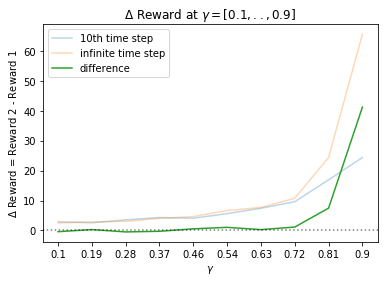

In [64]:
fig, ax = plt.subplots()

x = gamma_list

ax.plot(delta_r_10th, label="10th time step", alpha=0.3)
ax.plot(delta_r_inf, label="infinite time step", alpha=0.3)
ax.plot(np.array(delta_r_inf) - np.array(delta_r_10th), label= "difference")

ax.axhline(0, ax.get_xlim()[0], ax.get_xlim()[1],
           ls=':', color='k', alpha=0.5)

ax.set_title("$\Delta$ Reward at $\gamma = [0.1, .., 0.9]$")
ax.set_xticks(np.arange(len(gamma_list)))
ax.set_xticklabels(round(gamma, 2) for gamma in gamma_list)
ax.set_xlabel("$\gamma$")
ax.set_ylabel("$\Delta$ Reward = Reward 2 - Reward 1")
plt.legend()
plt.show()